In [41]:
import numpy as np
import matplotlib.pylab as pl
import ot
import ot.plot
import argparse
from pathlib import Path
from PIL import Image
from sklearn.neighbors import KNeighborsRegressor
import argparse
import time
from scipy.ndimage import map_coordinates
from sklearn.preprocessing import StandardScaler

## Helper Functions

In [44]:
def apply_3d_lut(X_full, X_samples, X_transported, grid_res=33):
    """Replaces KNN prediction with fast 3D texture mapping."""
    # Define the color cube bounds
    mins, maxs = np.array([0, 0, 0]), np.array([1, 1, 1])
    
    # 1. Learn the map on a regular grid using KNN (only grid_res^3 points)
    grid_1d = np.linspace(0, 1, grid_res)
    grid_points = np.stack(np.meshgrid(grid_1d, grid_1d, grid_1d, indexing='ij'), axis=-1).reshape(-1, 3)
    
    from sklearn.neighbors import KNeighborsRegressor
    knn = KNeighborsRegressor(n_neighbors=5, weights='distance')
    knn.fit(X_samples, X_transported)
    
    # This LUT stores "Where does this RGB color go?"
    lut = knn.predict(grid_points).reshape(grid_res, grid_res, grid_res, 3)
    
    # 2. Fast Map: Convert full image pixels to grid coordinates
    # map_coordinates handles trilinear interpolation automatically
    coords = X_full.reshape(-1, 3).T * (grid_res - 1)
    
    # Interpolate each RGB channel
    output = np.zeros_like(coords)
    lut_channels = lut.transpose(3, 0, 1, 2)
    for i in range(3):
        output[i] = map_coordinates(lut_channels[i], coords, order=1, mode='nearest')
        
    return output.T.reshape(X_full.shape)

In [46]:
def get_sym_power(matrix, power):
    """Robust symmetric matrix power using eigendecomposition."""
    evals, evecs = np.linalg.eigh(matrix)
    # Increased epsilon for stability at higher sample counts
    evals = np.maximum(evals, 1e-7) 
    return evecs @ np.diag(evals**power) @ evecs.T

## Algorithm 1: Preconditioning + LOT

In [49]:
def color_transfer_interpolation_regime(source_path, target_path, n_samples=5000):
    src_img = Image.open(source_path).convert('RGB')
    tgt_img = Image.open(target_path).convert('RGB')
    
    # This is X_full: The original 3D image array (H, W, 3)
    X_full = np.asarray(src_img, dtype=np.float64) / 255.0 
    
    # X_flat is just the flattened version of X_full for the math
    X_flat = X_full.reshape(-1, 3)
    Y_flat = np.asarray(tgt_img, dtype=np.float64).reshape(-1, 3) / 255.0
    
    # --- FIX STARTS HERE ---
    nx_samples = min(n_samples, len(X_flat))
    ny_samples = min(n_samples, len(Y_flat))

    idx_x = np.random.choice(len(X_flat), nx_samples, replace=False)
    idx_y = np.random.choice(len(Y_flat), ny_samples, replace=False)
    # --- FIX ENDS HERE ---

    X = X_flat[idx_x] 
    Y = Y_flat[idx_y]

    # ... rest of your code (Tabak, OT, apply_3d_lut) ...

    print(f"Aligning moments (Tabak Preconditioning)...")

    # 2. Tabak Preconditioning (Fixed Reference = Target)
    # ---------------------------------------------------------
    m_src = X.mean(axis=0)
    m_tgt = Y.mean(axis=0)
    C_src = np.cov(X - m_src, rowvar=False) + 1e-6 * np.eye(3)
    C_tgt = np.cov(Y - m_tgt, rowvar=False) + 1e-6 * np.eye(3)

    # Compute A: The map that pushes Source -> Target moments
    tgt_sqrt = get_sym_power(C_tgt, 0.5)
    inner = tgt_sqrt @ C_src @ tgt_sqrt
    inv_sqrt_inner = get_sym_power(inner, -0.5)
    A = tgt_sqrt @ inv_sqrt_inner @ tgt_sqrt

    # Apply Affine Map: X_aligned = A(X - m_src) + m_tgt
    X_aligned = (X - m_src) @ A.T + m_tgt

    print(f"Computing LOT Residuals (OT Map)...")

    # 3. Optimal Transport in Preconditioned Space
    # ---------------------------------------------------------
    # Now that X_aligned and Y are "close," we find the non-linear residual.
    M = ot.dist(X_aligned, Y, metric='sqeuclidean')
    a, b = np.ones(n_samples) / n_samples, np.ones(n_samples) / n_samples
    
    # Solve exact OT
    G = ot.emd(a, b, M)
    
    # Barycentric Projection: Find where aligned points go in Target space
    # T_resid(x) = (1/a) * G * Y
    X_transported = (G @ Y) * n_samples
    
    # 4. Optimized Reconstruction (No more slow knn.predict)
    X_final = apply_3d_lut(X_full, X, X_transported)
    
    X_final = np.clip(X_final, 0, 1)
    return Image.fromarray((X_final * 255).astype(np.uint8))

## Algorithm 2: + Sinkhorn

In [82]:
def preconditioned_color_transfer_sinkhorn(source_img_path, target_img_path, n_samples=5000):
    # 1. Load Data
    src_img = Image.open(source_img_path).convert('RGB')
    tgt_img = Image.open(target_img_path).convert('RGB')

    X_whole = np.asarray(src_img, dtype=np.float64) / 255.0
    Y_whole = np.asarray(tgt_img, dtype=np.float64) / 255.0
    
    X_full = np.asarray(src_img, dtype=np.float64).reshape(-1, 3) / 255.0
    Y_full = np.asarray(tgt_img, dtype=np.float64).reshape(-1, 3) / 255.0

    nx_samples = min(n_samples, len(X_full))
    ny_samples = min(n_samples, len(Y_full))

    idx_x = np.random.choice(len(X_full), nx_samples, replace=False)
    idx_y = np.random.choice(len(Y_full), ny_samples, replace=False)
    
    X = X_full[idx_x]
    Y = Y_full[idx_y]

    print(f"Aligning moments...")

    # 2. Robust Tabak Preconditioning
    m_src = X.mean(axis=0)
    m_tgt = Y.mean(axis=0)
    # Added stronger regularization to the diagonal to prevent black-spot 'singularities'
    C_src = np.cov(X - m_src, rowvar=False) + 1e-4 * np.eye(3)
    C_tgt = np.cov(Y - m_tgt, rowvar=False) + 1e-4 * np.eye(3)

    tgt_sqrt = get_sym_power(C_tgt, 0.5)
    inner = tgt_sqrt @ C_src @ tgt_sqrt
    inv_sqrt_inner = get_sym_power(inner, -0.5)
    A = tgt_sqrt @ inv_sqrt_inner @ tgt_sqrt

    X_aligned = (X - m_src) @ A.T + m_tgt

    print(f"Computing Regularized OT Residuals...")

    # 3. Sinkhorn instead of EMD (Fixes numerical black spots)
    # ---------------------------------------------------------
    M = ot.dist(X_aligned, Y, metric='sqeuclidean')
    M /= M.max() # Normalize distance matrix for Sinkhorn stability
    
    a, b = np.ones(n_samples) / n_samples, np.ones(n_samples) / n_samples
    
    # reg=0.01 provides enough smoothness to prevent 'noise' while keeping color fidelity
    G = ot.sinkhorn(a, b, M, reg=0.01)
    
    # T_resid(x) = (1/a) * G * Y
    X_transported = (G @ Y) * n_samples

    # 4. Optimized Reconstruction (No more slow knn.predict)
    X_final = apply_3d_lut(X_whole, X, X_transported)
    
    X_final = np.clip(X_final, 0, 1)
    return Image.fromarray((X_final * 255).astype(np.uint8))

## Tests

### Algorithm 1

In [70]:
start = time.time()
out_1 = color_transfer_interpolation_regime("penacony.png", "sunset.jpg", n_samples=5000)
end = time.time()
print(end - start)

Aligning moments (Tabak Preconditioning)...
Computing LOT Residuals (OT Map)...


C:\Users\mycos\anaconda3\lib\site-packages\ot\lp\__init__.py:354: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  result_code_string = check_result(result_code)


6.5037853717803955


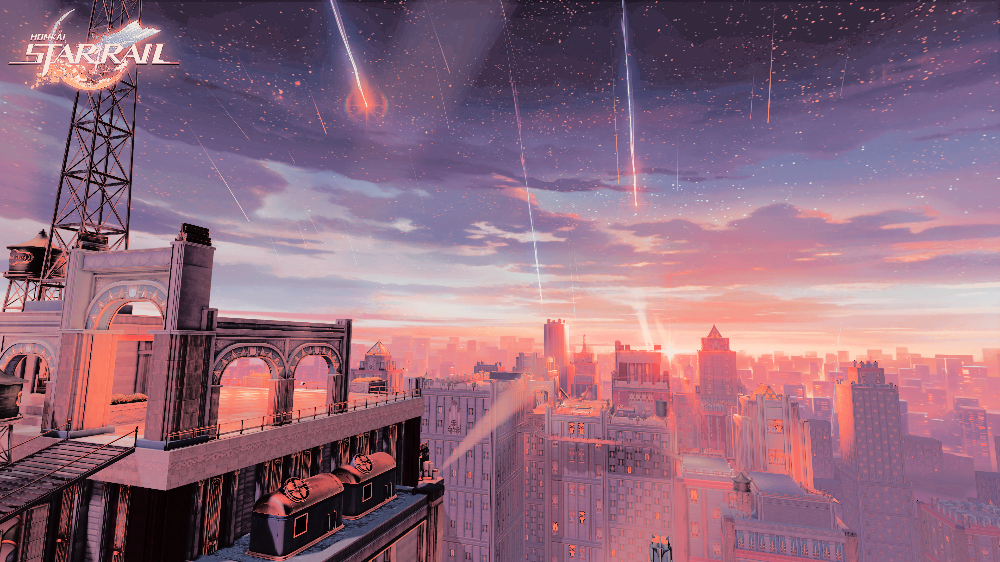

In [71]:
out_1

### Algorithm 2

In [85]:
start = time.time()
out_2 = preconditioned_color_transfer_sinkhorn("penacony.png", "sunset.jpg", n_samples=5000)
end = time.time()
print(end - start)

Aligning moments...
Computing Regularized OT Residuals...
5.5418701171875


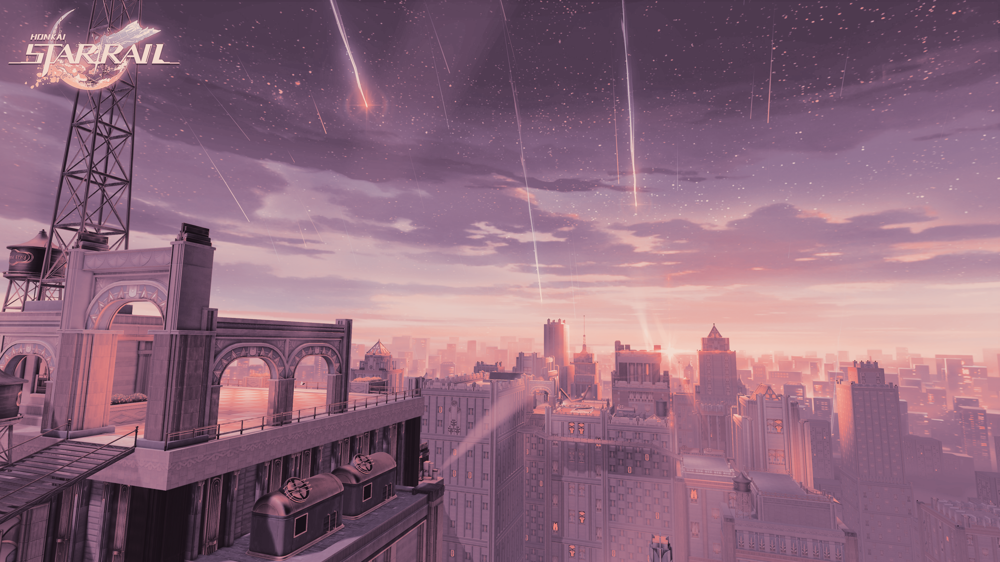

In [86]:
out_2